In [ ]:
!pip3 install backtrader[plotting]
!pip3 install pyfolio

     |████████████████████████████████| 410 kB 5.7 MB/s 
     |████████████████████████████████| 91 kB 4.2 MB/s 
     |████████████████████████████████| 52 kB 1.2 MB/s 
  Created wheel for pyfolio: filename=pyfolio-0.9.2-py3-none-any.whl size=88681 sha256=774837671e85feb02ee67f251e6211f0777aaa374ffb7a10b13ae87c8fa9db85
  Stored in directory: /root/.cache/pip/wheels/e4/96/9b/0dfff5453e702fd780a099b7c850521099c5ec0dfafae189f9
  Created wheel for empyrical: filename=empyrical-0.5.5-py3-none-any.whl size=39777 sha256=57f0e8518450f1b6b1e166a3e7cfbd017c31e2e9c95196af0571e381928cb7d3
  Stored in directory: /root/.cache/pip/wheels/d9/91/4b/654fcff57477efcf149eaca236da2fce991526cbab431bf312
Successfully built pyfolio empyrical


In [ ]:
import matplotlib.pyplot as plt
from datetime import datetime
import backtrader as bt
import pandas as pd
import numpy as np
import math 
import statistics
from sklearn.metrics import mean_squared_error, mean_absolute_error
import scipy.stats as st
import datetime as dt
import pyfolio as pf
from scipy.optimize import minimize

from sklearn.linear_model import LinearRegression

# Connect to google drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)


/usr/local/lib/python3.7/dist-packages/pyfolio/pos.py:27: UserWarning: Module "zipline.assets" not found; mutltipliers will not be applied to position notionals.
  'Module "zipline.assets" not found; mutltipliers will not be applied' +


Mounted at /content/drive


# Normal Kelly criterion

In [ ]:
class Normal_Kelly_Strategy(bt.Strategy):
    params = dict(log_period = 1)

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.datetime(0)
        print('%s, %s' % (dt.isoformat(), txt))

    def notify_order(self, order):
        if order.status in [order.Submitted, order.Accepted]:
            # Buy/Sell order submitted/accepted to/by broker - Nothing to do
            return

        # Check if an order has been completed
        # Attention: broker could reject order if not enough cash
        if order.status in [order.Completed]:
            if order.isbuy():
                self.log(
                    'BUY EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                    (order.executed.price,
                     order.executed.value,
                     order.executed.comm))

                self.buyprice = order.executed.price
                self.buycomm = order.executed.comm
            else:  # Sell
                self.log('SELL EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                         (order.executed.price,
                          order.executed.value,
                          order.executed.comm))

            self.bar_executed = len(self)

        elif order.status in [order.Canceled, order.Margin, order.Rejected]:
            self.log('Order Canceled/Margin/Rejected')

        # Write down: no pending order
        self.order = None
    def start(self):
        self.order = None 

    def __init__(self):
        self.data_close = self.datas[0].close
        self.log_return_list = []
        self.init_price = 0 
        self.current_f = 0
        self.reg = None
        self.sxx = np.zeros((TIME_STEPS, TIME_STEPS)) # S = S_xx
        self.sigma = 0
        self.x_mean = None
        self.dof = 0
        self.n = 0

    def next(self):
        # Simply log the closing price of the series from the reference
        #self.log('')
        if (len(self) == 1):
          self.init_price = self.datas[0].close.get(size = 1)
            
        
        elif (len(self) >= 60):
            current_data = pd.Series(list(self.data_close.get(size=30)))
            current_ret = current_data.pct_change().dropna()
            current_log = np.log(current_data/ current_data.shift(1))

            self.current_mu = (np.mean(current_log) * 252)
            self.current_sigma = (np.std(current_log)  * 252 ** 0.5)
            print('Current mu = ', self.current_mu)
            print('Current sigma = ', self.current_sigma)
            if self.current_sigma != 0 :
              self.current_f = (self.current_mu/(self.current_sigma ** 2))
            if self.current_f < 0 :
              self.current_f = 0
            elif self.current_f > 1 :
              self.current_f = 1
            print(self.current_f)
            #self.log('Current f %.4f' %self.current_f)
            self.order = self.order_target_percent(target = self.current_f)
            self.log('%04d - Order Target Percent: %.4f' %(len(self), self.current_f))
            #self.log(self.broker.getvalue())
            #self.log('Portfolio value %.2f' %data_value)
        


In [ ]:
TIME_STEPS = 24 # How far in the past you want to use past data as features
TARGET_TIME_STEPS = 12 # How far in the future you want to make predictions
#INP_COLS = [0, 1, 2, 3, 4]
INP_COLS = [1]
OUT_COL = 1

# Phase 1

## Cryptocurrency 

### USD - BTC

In [ ]:
btc_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BTC-USD.csv', index_col=0, parse_dates=True)
btc_data.dropna(inplace=True)
train_len = int(0.7 * len(btc_data))
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=btc_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  1.3394887872699184
Current sigma =  0.4159424104002657
1
2020-01-24T00:00:00, 0060 - Order Target Percent: 1.0000
2020-01-25T00:00:00, BUY EXECUTED, Price: 8445.43, Cost: 996561.28, Comm 0.00
Current mu =  1.198138625896348
Current sigma =  0.4180207352887163
1
2020-01-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  1.3995368113166617
Current sigma =  0.4229323149883411
1
2020-01-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  1.5868826422275342
Current sigma =  0.4312905706761839
1
2020-01-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  2.1670288745463995
Current sigma =  0.44232876335833654
1
2020-01-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  2.247226016099926
Current sigma =  0.4390774776163492
1
2020-01-29T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  2.4168778058764238
Current sigma =  0.4396262429445058
1
2020-01-30T00:00:00, 0066 - Order Target Percen

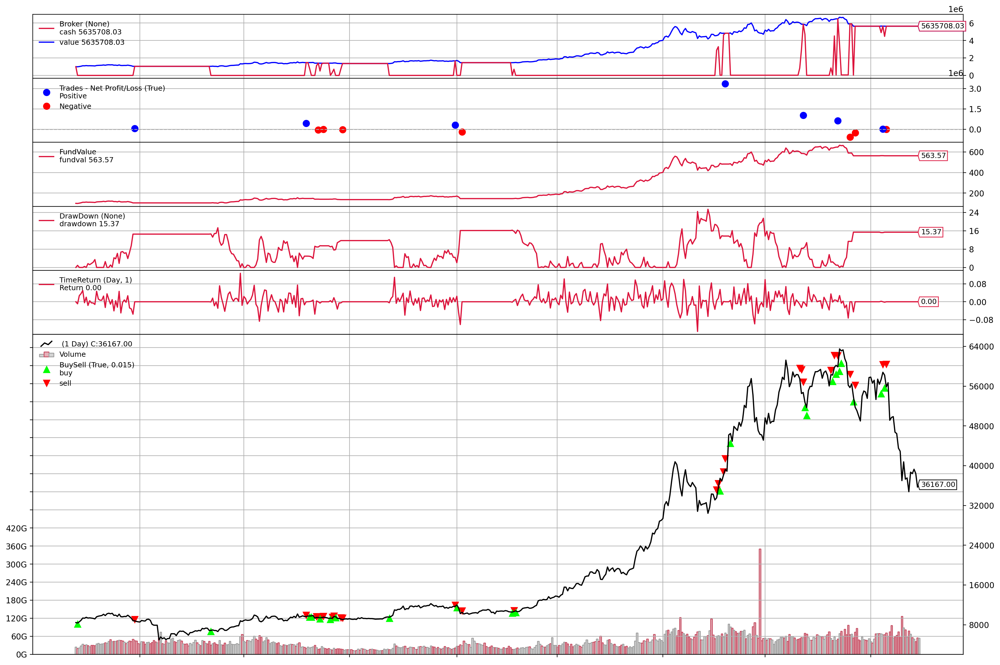

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - ETH

In [ ]:
eth_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/ETH-USD.csv', index_col=0, parse_dates=True)
eth_data.dropna(inplace=True)
train_len = int(0.7 * len(eth_data))
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=eth_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  2.215162449461752
Current sigma =  0.5595571843833307
1
2020-01-24T00:00:00, 0060 - Order Target Percent: 1.0000
2020-01-25T00:00:00, BUY EXECUTED, Price: 163.05, Cost: 999992.87, Comm 0.00
Current mu =  2.0619761845645317
Current sigma =  0.5624433745827309
1
2020-01-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  2.345116980574309
Current sigma =  0.5705504754017228
1
2020-01-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  2.066216748211526
Current sigma =  0.5586297245064796
1
2020-01-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  2.47651946849124
Current sigma =  0.5576773626761763
1
2020-01-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  2.611563295073237
Current sigma =  0.551497726990097
1
2020-01-29T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  2.9979012380492365
Current sigma =  0.5655041515646339
1
2020-01-30T00:00:00, 0066 - Order Target Percent: 1.00

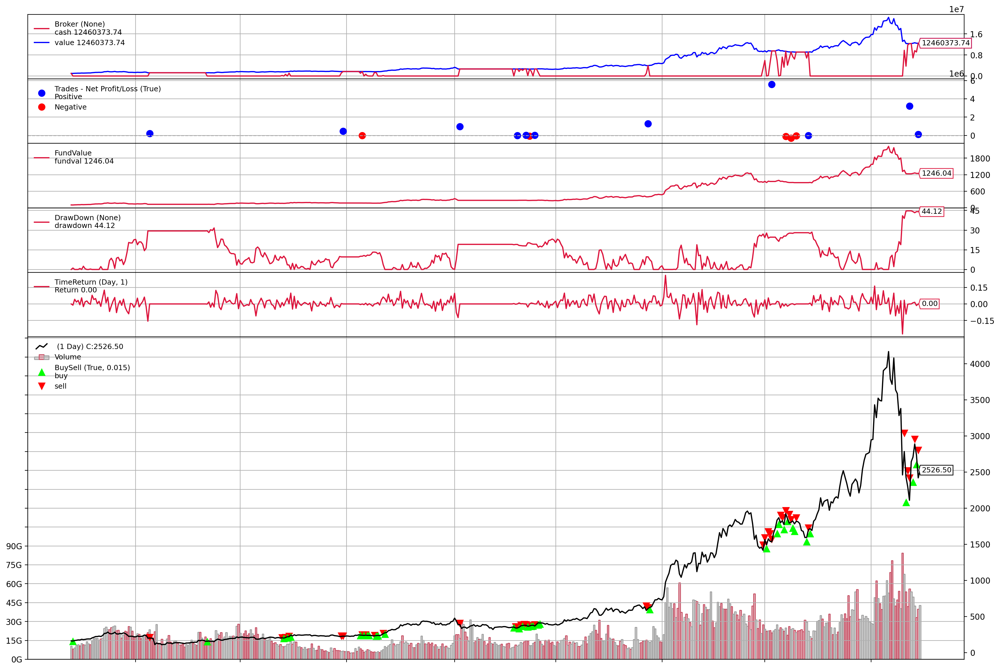

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - DOGE

In [ ]:
doge_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/DOGE-USD.csv', index_col=0, parse_dates=True)
doge_data.dropna(inplace=True)
train_len = int(0.7 * len(doge_data))
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=doge_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.8749168783021085
Current sigma =  0.5113853832092358
1
2020-01-24T00:00:00, 0060 - Order Target Percent: 1.0000
2020-01-25T00:00:00, BUY EXECUTED, Price: 0.00, Cost: 1000000.00, Comm 0.00
Current mu =  0.8232089196292315
Current sigma =  0.5122720931988204
1
2020-01-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.9596405815511203
Current sigma =  0.514837463907969
1
2020-01-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  1.1771333660222503
Current sigma =  0.519133150075618
1
2020-01-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  1.5319767616781996
Current sigma =  0.5247416485266061
1
2020-01-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  1.4272174694499824
Current sigma =  0.5296375844997578
1
2020-01-29T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  1.5857361094497582
Current sigma =  0.5313126354759382
1
2020-01-30T00:00:00, 0066 - Order Target Percent: 

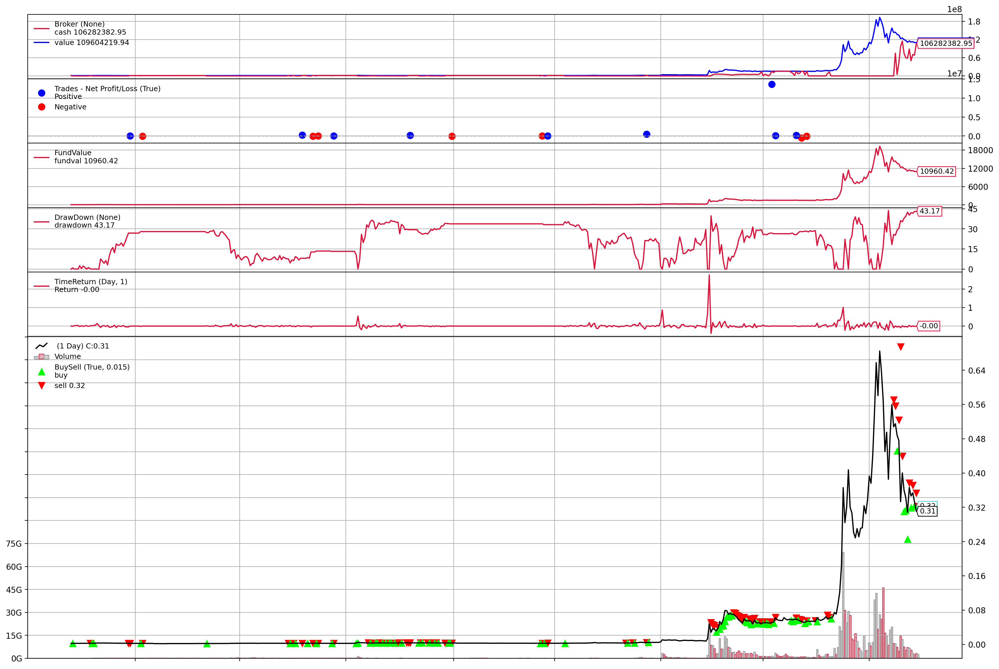

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - XRP

In [ ]:
xrp_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/XRP-USD.csv', index_col=0, parse_dates=True)
xrp_data.dropna(inplace=True)
train_len = int(0.7 * len(xrp_data))
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=xrp_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  1.3752248432895893
Current sigma =  0.5649757158039704
1
2020-01-24T00:00:00, 0060 - Order Target Percent: 1.0000
2020-01-25T00:00:00, BUY EXECUTED, Price: 0.22, Cost: 999999.86, Comm 0.00
Current mu =  1.2405287194470414
Current sigma =  0.567171655402724
1
2020-01-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  1.5399606298906303
Current sigma =  0.5790550495063269
1
2020-01-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  1.3896123721922486
Current sigma =  0.5777139519011173
1
2020-01-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  1.772867937062023
Current sigma =  0.5794451813170997
1
2020-01-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  1.7426779068226341
Current sigma =  0.5803234739496047
1
2020-01-29T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  2.039780324637966
Current sigma =  0.5846146240236012
1
2020-01-30T00:00:00, 0066 - Order Target Percent: 1.

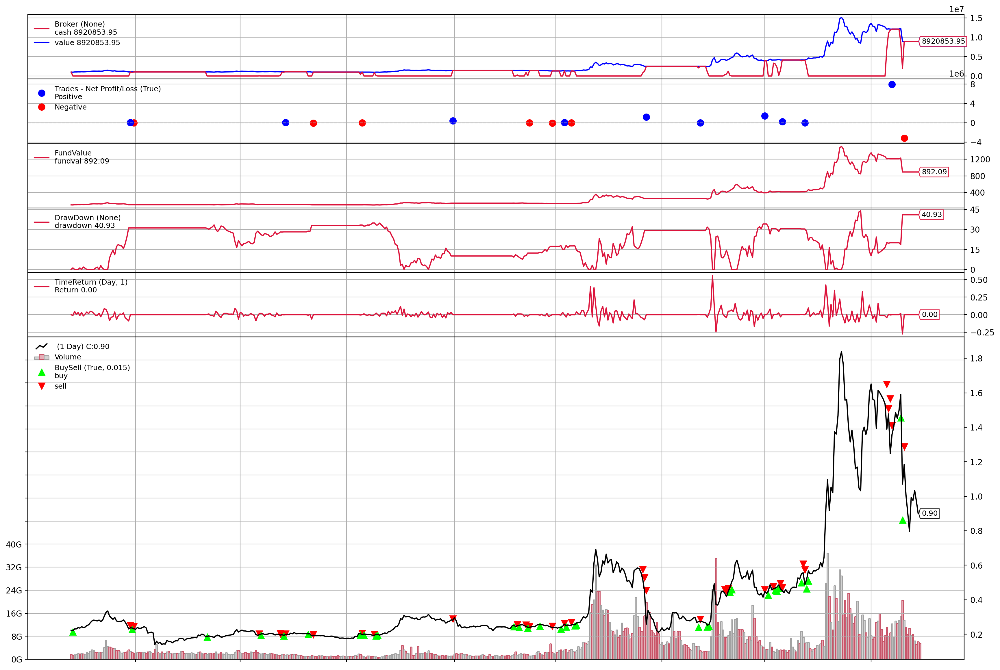

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - LTC

In [ ]:
ltc_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/LTC-USD.csv', index_col=0, parse_dates=True)
ltc_data.dropna(inplace=True)
train_len = int(0.7 * len(ltc_data))
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=ltc_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  2.635358981937691
Current sigma =  0.7004919649683243
1
2020-01-24T00:00:00, 0060 - Order Target Percent: 1.0000
2020-01-25T00:00:00, BUY EXECUTED, Price: 54.53, Cost: 999949.40, Comm 0.00
Current mu =  2.3067860537703866
Current sigma =  0.7034463726363064
1
2020-01-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  2.3602134284695238
Current sigma =  0.7059813788081893
1
2020-01-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  2.5794418546169684
Current sigma =  0.7127676145292281
1
2020-01-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  3.042877457704219
Current sigma =  0.7089479116673272
1
2020-01-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  3.2482826006832664
Current sigma =  0.6989870249346222
1
2020-01-29T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  4.203644624745214
Current sigma =  0.7722908766427864
1
2020-01-30T00:00:00, 0066 - Order Target Percent: 1

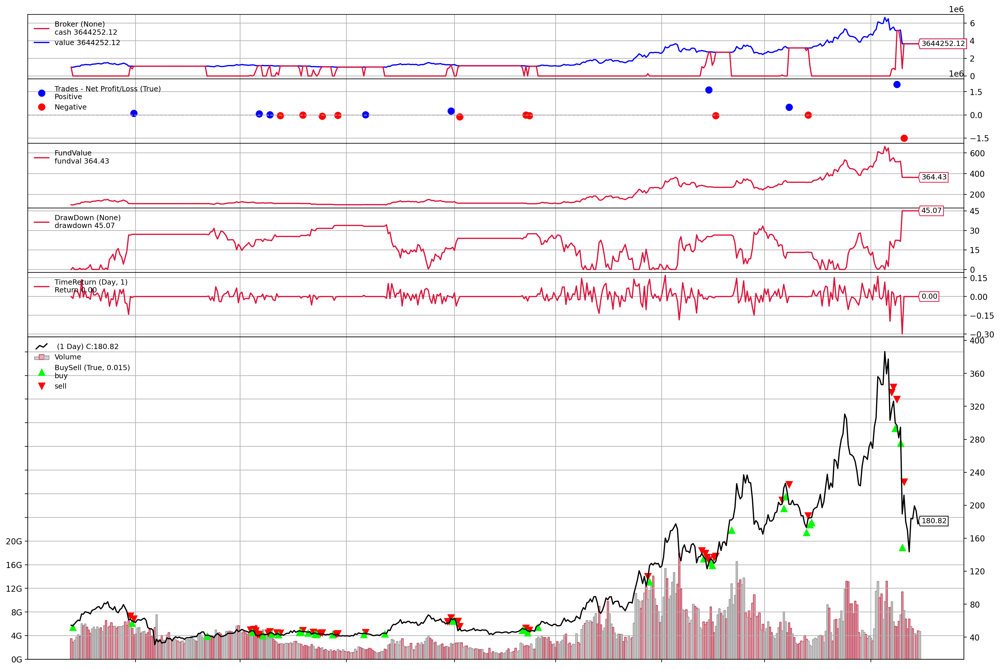

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - BCH

In [ ]:
bch_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BCH-USD.csv', index_col=0, parse_dates=True)
bch_data.dropna(inplace=True)
train_len = int(0.7 * len(bch_data))
train_len

982

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=bch_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  -0.20262723692576798
Current sigma =  0.5609486166093691
0
2020-05-30T00:00:00, 0060 - Order Target Percent: 0.0000
Current mu =  -0.7658873672981664
Current sigma =  0.5730558762952663
0
2020-05-31T00:00:00, 0061 - Order Target Percent: 0.0000
Current mu =  0.0960757301982157
Current sigma =  0.5941023784713753
0.27220187458854284
2020-06-01T00:00:00, 0062 - Order Target Percent: 0.2722
2020-06-02T00:00:00, BUY EXECUTED, Price: 255.35, Cost: 271950.08, Comm 0.00
Current mu =  0.12593751501792935
Current sigma =  0.5927368613522994
0.35845219759782854
2020-06-02T00:00:00, 0063 - Order Target Percent: 0.3585
2020-06-03T00:00:00, BUY EXECUTED, Price: 249.05, Cost: 90655.37, Comm 0.00
Current mu =  0.2614602881813342
Current sigma =  0.5935247508306177
0.7422121625114817
2020-06-03T00:00:00, 0064 - Order Target Percent: 0.7422
2020-06-04T00:00:00, BUY EXECUTED, Price: 252.06, Cost: 380111.93, Comm 0.00
Current mu =  0.375959383017672
Curr

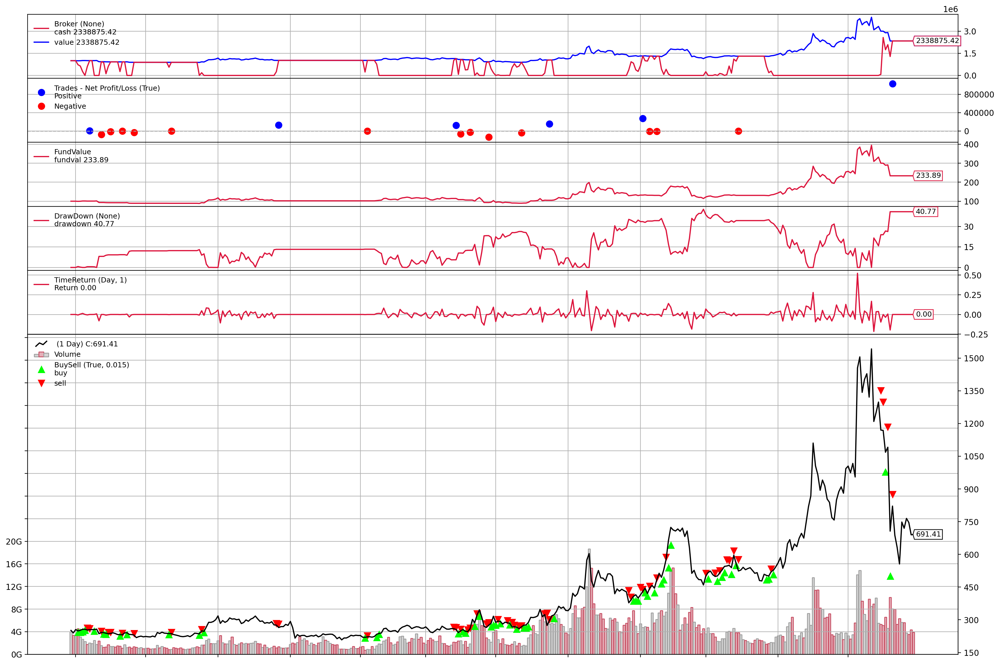

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 5, 30), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-5-30',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - ADA

In [ ]:
ada_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/ADA-USD.csv', index_col=0, parse_dates=True)
ada_data.dropna(inplace=True)
train_len = int(0.7 * len(ada_data))
train_len

933

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=ada_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  3.0532382443337065
Current sigma =  0.914196092522387
1
2020-06-20T00:00:00, 0060 - Order Target Percent: 1.0000
2020-06-21T00:00:00, BUY EXECUTED, Price: 0.08, Cost: 999999.94, Comm 0.00
Current mu =  3.03798550725332
Current sigma =  0.914565706090335
1
2020-06-21T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  4.020424044273946
Current sigma =  0.9068515221929464
1
2020-06-22T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  3.728299046639343
Current sigma =  0.9089400002770253
1
2020-06-23T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  3.783749258061355
Current sigma =  0.9075645323686
1
2020-06-24T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  3.4088552849851035
Current sigma =  0.9090338027918238
1
2020-06-25T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  1.9241948972713359
Current sigma =  0.8034068260935809
1
2020-06-26T00:00:00, 0066 - Order Target Percent: 1.0000
Cu

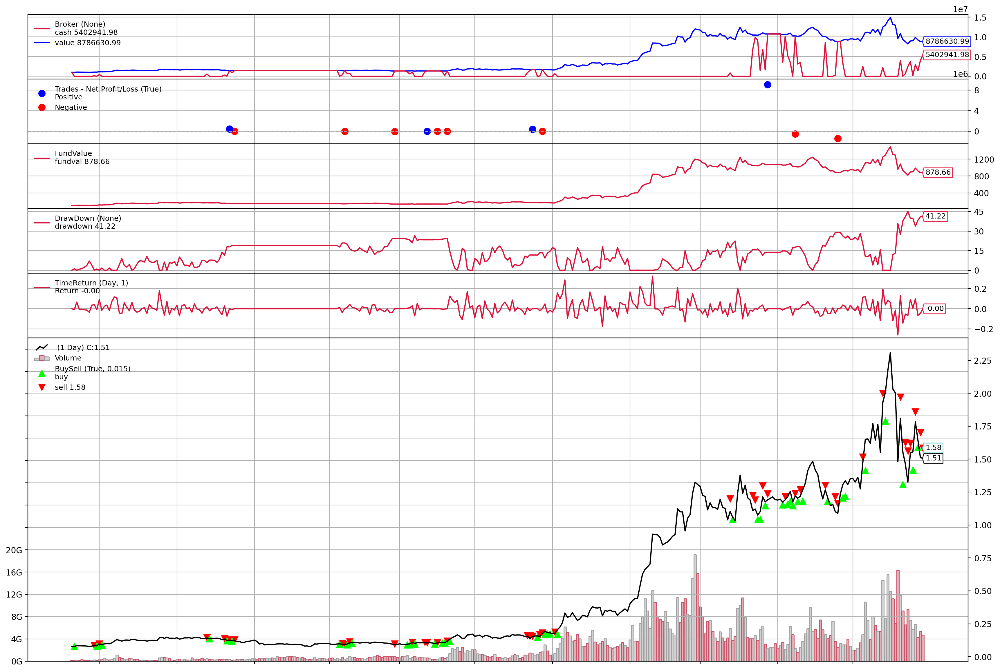

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 6, 20), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-6-20',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - BNB

In [ ]:
bnb_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BNB-USD.csv', index_col=0, parse_dates=True)
bnb_data.dropna(inplace=True)
train_len = int(0.7 * len(bnb_data))
train_len

980

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=bnb_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.08782411204241788
Current sigma =  0.47880619340339714
0.38308420744984584
2020-05-30T00:00:00, 0060 - Order Target Percent: 0.3831
2020-05-31T00:00:00, BUY EXECUTED, Price: 17.74, Cost: 383080.39, Comm 0.00
Current mu =  -0.2732860590872549
Current sigma =  0.49313061535104835
0
2020-05-31T00:00:00, 0061 - Order Target Percent: 0.0000
2020-06-01T00:00:00, SELL EXECUTED, Price: 17.04, Cost: 383080.39, Comm 0.00
Current mu =  0.39120721533391034
Current sigma =  0.5084890123885519
1
2020-06-01T00:00:00, 0062 - Order Target Percent: 1.0000
2020-06-02T00:00:00, BUY EXECUTED, Price: 17.91, Cost: 984820.19, Comm 0.00
Current mu =  0.07011874046811038
Current sigma =  0.521509154768822
0.2578162179051351
2020-06-02T00:00:00, 0063 - Order Target Percent: 0.2578
2020-06-03T00:00:00, SELL EXECUTED, Price: 17.24, Cost: 730911.72, Comm 0.00
Current mu =  0.31551250765929706
Current sigma =  0.5227851816705699
1
2020-06-03T00:00:00, 0064 - Order

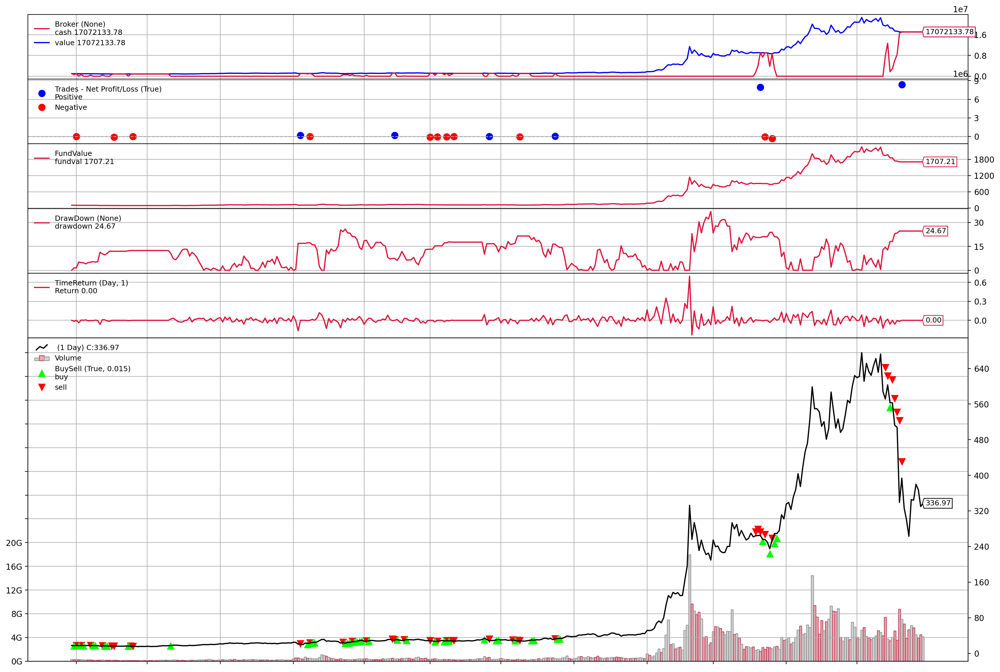

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 5, 30), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-5-30',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


## Stocks (S&P 500 big cap)

### AAPL

In [ ]:
aapl_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/AAPL.csv', index_col=0, parse_dates=True)
aapl_data.dropna(inplace=True)
train_len = int(0.9 * len(aapl_data))
train_len

2264

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=aapl_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  1.5610466842818997
Current sigma =  0.3890029888539857
1
2020-08-04T00:00:00, 0060 - Order Target Percent: 1.0000
2020-08-05T00:00:00, BUY EXECUTED, Price: 109.67, Cost: 999925.48, Comm 0.00
Current mu =  1.7472469900874747
Current sigma =  0.3824086583083958
1
2020-08-05T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  1.9306524222744827
Current sigma =  0.3902155542235782
1
2020-08-06T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  1.9863370763719659
Current sigma =  0.3850764768652157
1
2020-08-07T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  1.913735616226065
Current sigma =  0.38302170080900017
1
2020-08-10T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  1.5791491408290306
Current sigma =  0.3983256683042529
1
2020-08-11T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  1.8797002676952683
Current sigma =  0.4047163091731191
1
2020-08-12T00:00:00, 0066 - Order Target Percen

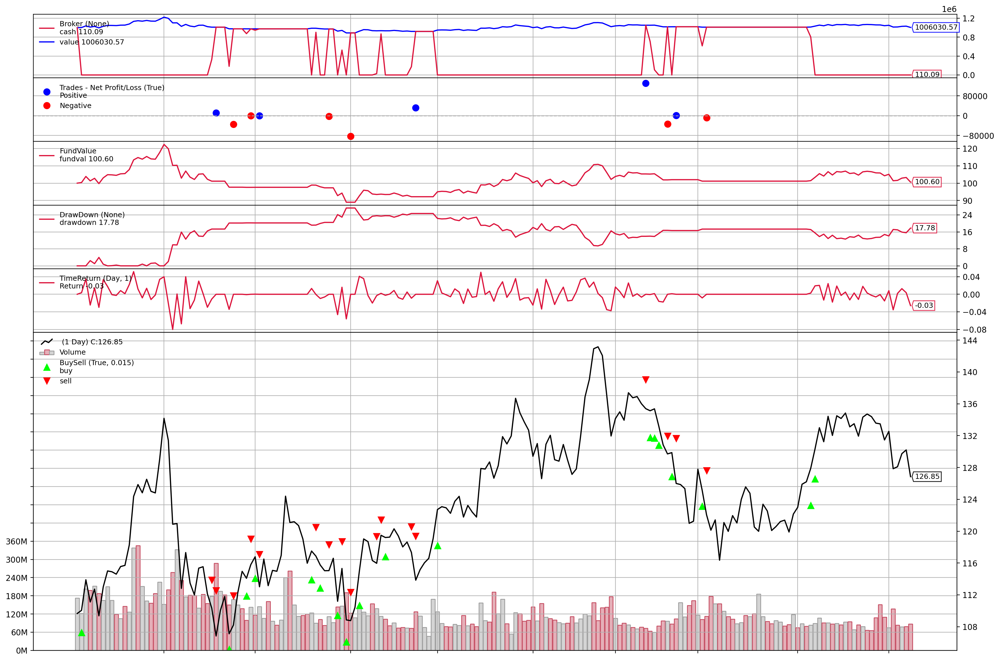

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 8, 4), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-8-4',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### Yahoo

In [ ]:
yahoo_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/yhoo-1996-2015.txt', index_col=0, parse_dates=True)
yahoo_data.dropna(inplace=True)
train_len = int(0.9 * len(yahoo_data))
train_len

4468

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=yahoo_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  -0.9227349777808092
Current sigma =  0.318244751229447
0
2014-04-08T00:00:00, 0060 - Order Target Percent: 0.0000
Current mu =  -0.8537752244384709
Current sigma =  0.3246454146881234
0
2014-04-09T00:00:00, 0061 - Order Target Percent: 0.0000
Current mu =  -1.2731048171459063
Current sigma =  0.34313560047360386
0
2014-04-10T00:00:00, 0062 - Order Target Percent: 0.0000
Current mu =  -1.317205764167666
Current sigma =  0.344203067331435
0
2014-04-11T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  -1.4731973525334305
Current sigma =  0.3293799354333493
0
2014-04-14T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -1.2494221014307956
Current sigma =  0.3394126059182184
0
2014-04-15T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  -0.7572945338432542
Current sigma =  0.3885481056214966
0
2014-04-16T00:00:00, 0066 - Order Target Percent: 0.0000
Current mu =  -0.5371981784509113
Current sigma =  0.383260614

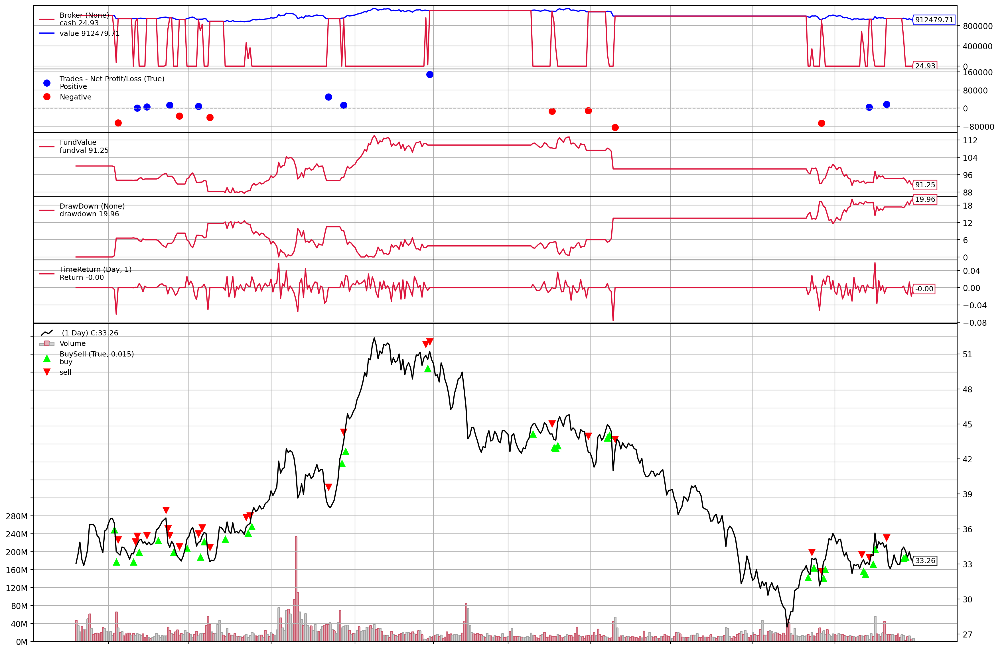

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2014, 4, 7), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2014-4-8',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### FB

In [ ]:
fb_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/FB.csv', index_col=0, parse_dates=True)
fb_data.dropna(inplace=True)
train_len = int(0.7 * len(fb_data))
train_len

1584

In [ ]:
fb_data[train_len:]

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2018-09-05,169.490005,171.130005,166.669998,167.179993,167.179993,31226700
2018-09-06,166.979996,166.979996,160.000000,162.529999,162.529999,41514800
2018-09-07,160.309998,164.630005,160.160004,163.039993,163.039993,24300600
2018-09-10,163.509995,165.009995,162.160004,164.179993,164.179993,20197700
2018-09-11,163.940002,167.190002,163.720001,165.940002,165.940002,20457100
...,...,...,...,...,...,...
2021-05-12,301.130005,304.959991,298.190002,302.549988,302.549988,24645500
2021-05-13,306.079987,308.859985,302.769989,305.260010,305.260010,18079200
2021-05-14,309.540009,316.850006,309.079987,315.940002,315.940002,19230600


In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=fb_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")


# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  -1.3322517737029862
Current sigma =  0.38853687602776976
0
2018-11-28T00:00:00, 0060 - Order Target Percent: 0.0000
Current mu =  -0.9622904273010595
Current sigma =  0.38586799894081797
0
2018-11-29T00:00:00, 0061 - Order Target Percent: 0.0000
Current mu =  -0.7932537404887728
Current sigma =  0.38917350017357905
0
2018-11-30T00:00:00, 0062 - Order Target Percent: 0.0000
Current mu =  -0.8047210813449985
Current sigma =  0.38896015995548305
0
2018-12-03T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  -0.9796335143310586
Current sigma =  0.3930074278568699
0
2018-12-04T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -0.3900300115609812
Current sigma =  0.36345458195063246
0
2018-12-06T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  -0.8160170258581668
Current sigma =  0.35038576656051884
0
2018-12-07T00:00:00, 0066 - Order Target Percent: 0.0000
Current mu =  -0.21300064067327873
Current sigma =  0.

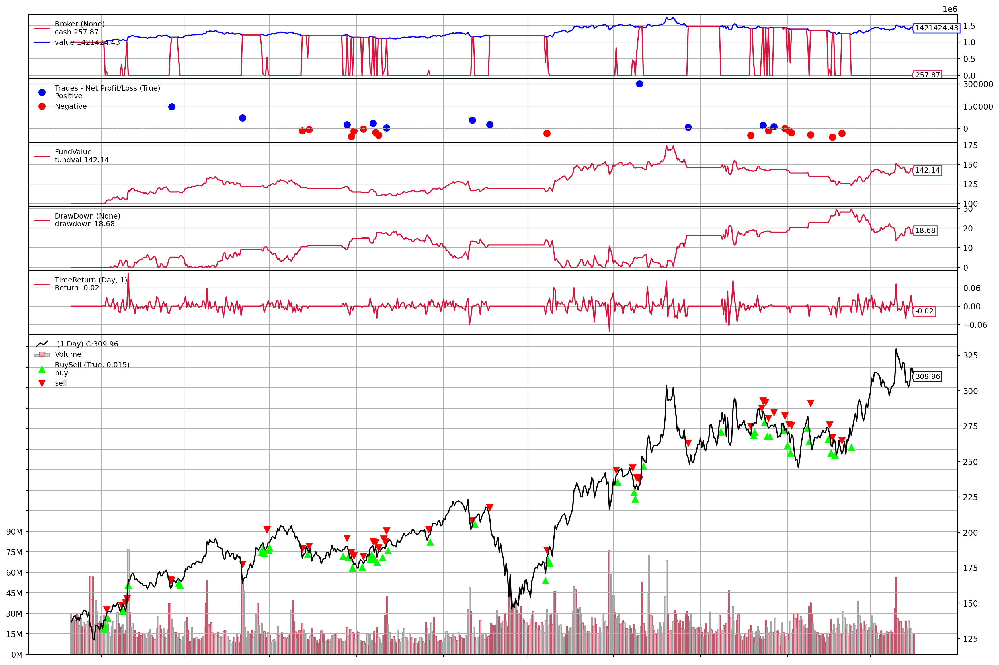

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 11, 28), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-11-27',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### TSLA

In [ ]:
tsla_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/TSLA.csv', index_col=0, parse_dates=True)
tsla_data.dropna(inplace=True)
train_len = int(0.7 * len(tsla_data))
train_len

1761

In [ ]:
tsla_data[train_len + 60:]

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2018-08-14,71.690002,71.839996,69.419998,69.528000,69.528000,34932000
2018-08-15,68.382004,68.898003,66.428001,67.737999,67.737999,45506500
2018-08-16,67.982002,68.456001,66.764000,67.089996,67.089996,30320000
2018-08-17,64.699997,65.353996,60.706001,61.099998,61.099998,94793000
2018-08-20,58.340000,61.700001,57.639999,61.688000,61.688000,87011500
...,...,...,...,...,...,...
2021-05-12,602.489990,620.409973,586.770020,589.890015,589.890015,33823600
2021-05-13,601.539978,606.460022,559.650024,571.690002,571.690002,44184900
2021-05-14,583.409973,592.869995,570.460022,589.739990,589.739990,33230600


In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=tsla_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.5365189514507446
Current sigma =  0.6718097908554823
1
2018-08-13T00:00:00, 0060 - Order Target Percent: 1.0000
2018-08-14T00:00:00, BUY EXECUTED, Price: 71.28, Cost: 999943.87, Comm 0.00
Current mu =  0.971718912013256
Current sigma =  0.6365865234119091
1
2018-08-14T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.7927247556291014
Current sigma =  0.6419858226540575
1
2018-08-15T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.7165078690915445
Current sigma =  0.6429611281843977
1
2018-08-16T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  -0.3623944726007513
Current sigma =  0.694812087339124
0
2018-08-17T00:00:00, 0064 - Order Target Percent: 0.0000
2018-08-20T00:00:00, SELL EXECUTED, Price: 61.10, Cost: 999943.87, Comm 0.00
Current mu =  -0.3865403686716371
Current sigma =  0.6943791925019652
0
2018-08-20T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  0.07972922536557082
Current 

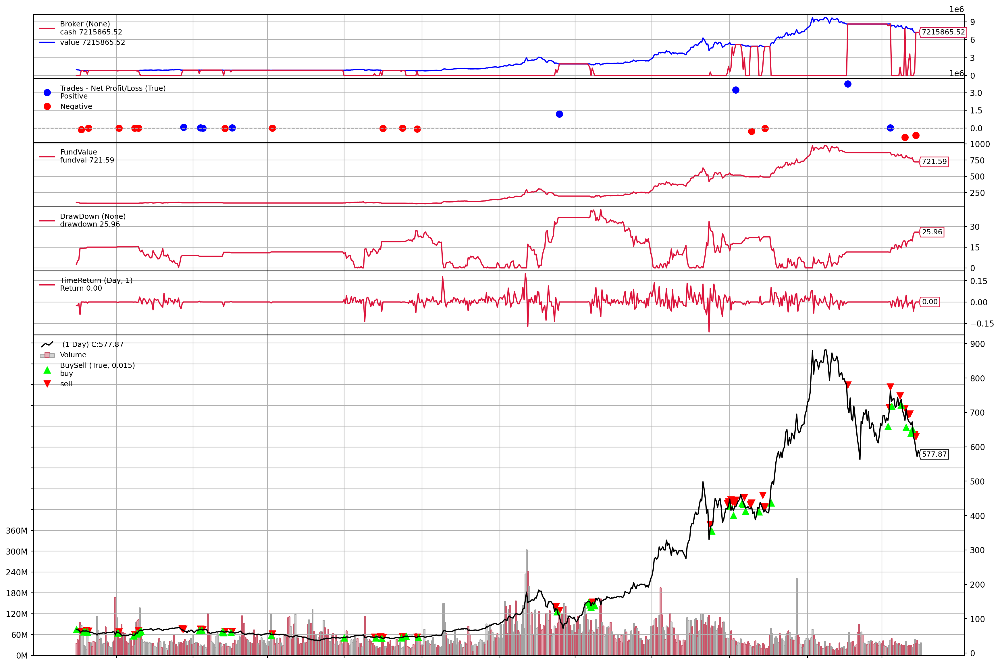

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### GOOGL

In [ ]:
googl_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/GOOGL.csv', index_col=0, parse_dates=True)
googl_data.dropna(inplace=True)
train_len = int(0.7 * len(googl_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=googl_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)
cerebro.broker.set_coc(True)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.7749222048705117
Current sigma =  0.21367663684526805
1
2018-08-13T00:00:00, 0060 - Order Target Percent: 1.0000
2018-08-14T00:00:00, BUY EXECUTED, Price: 1248.64, Cost: 998912.01, Comm 0.00
Current mu =  1.0395668863654999
Current sigma =  0.19925891966412737
1
2018-08-14T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.666132987764967
Current sigma =  0.20428215737986202
1
2018-08-15T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.5040320052602649
Current sigma =  0.20399522968349457
1
2018-08-16T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.3542522161712234
Current sigma =  0.2038589938314125
1
2018-08-17T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.3987819933262274
Current sigma =  0.2040659987857448
1
2018-08-20T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.33433342581531716
Current sigma =  0.2045292477506486
1
2018-08-21T00:00:00, 0066 - Order Target P

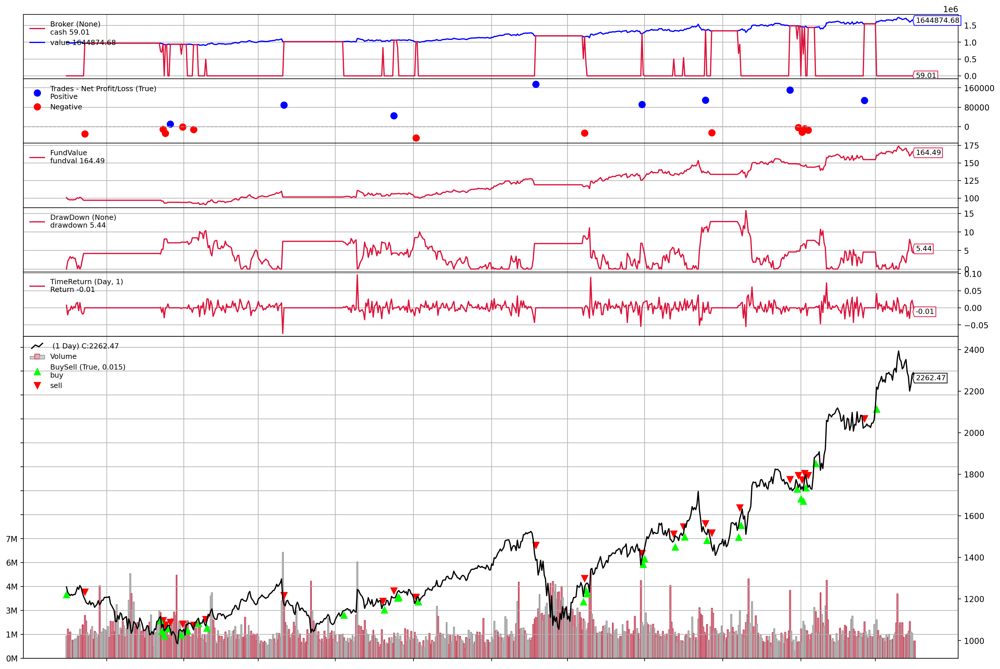

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### BRK-B

In [ ]:
brkb_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BRK-B.csv', index_col=0, parse_dates=True)
brkb_data.dropna(inplace=True)
train_len = int(0.7 * len(brkb_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=brkb_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.7673103244525858
Current sigma =  0.196423749416673
1
2018-08-13T00:00:00, 0060 - Order Target Percent: 1.0000
2018-08-14T00:00:00, BUY EXECUTED, Price: 205.17, Cost: 999998.57, Comm 0.00
Current mu =  0.8793616362107134
Current sigma =  0.1926784157846257
1
2018-08-14T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.7541676130428421
Current sigma =  0.19430898335924418
1
2018-08-15T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.8804502982421072
Current sigma =  0.19711126492980136
1
2018-08-16T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.8088625843589818
Current sigma =  0.1958148633539068
1
2018-08-17T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.8103070746331095
Current sigma =  0.19580188364237885
1
2018-08-20T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.8110994146239393
Current sigma =  0.19578926267263755
1
2018-08-21T00:00:00, 0066 - Order Target Per

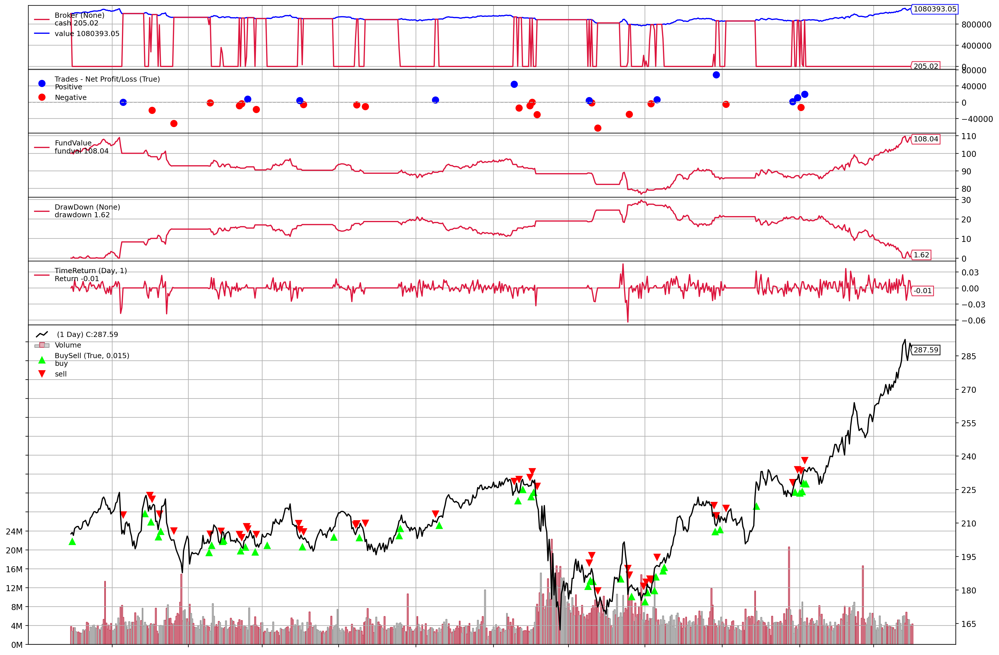

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 13), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### JPM

In [ ]:
jpm_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/JPM.csv', index_col=0, parse_dates=True)
jpm_data.dropna(inplace=True)
train_len = int(0.7 * len(jpm_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=jpm_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.699613502384865
Current sigma =  0.1951818689428907
1
2018-08-13T00:00:00, 0060 - Order Target Percent: 1.0000
2018-08-14T00:00:00, BUY EXECUTED, Price: 113.89, Cost: 999954.19, Comm 0.00
Current mu =  0.8798290359287552
Current sigma =  0.18874889752314725
1
2018-08-14T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.7983047525166882
Current sigma =  0.1917312357454071
1
2018-08-15T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.8512600225357962
Current sigma =  0.1925708951903166
1
2018-08-16T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.5864463177631988
Current sigma =  0.17471196490350913
1
2018-08-17T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.6287069425106029
Current sigma =  0.173217860905321
1
2018-08-20T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.700380077572731
Current sigma =  0.17293933663815586
1
2018-08-21T00:00:00, 0066 - Order Target Percen

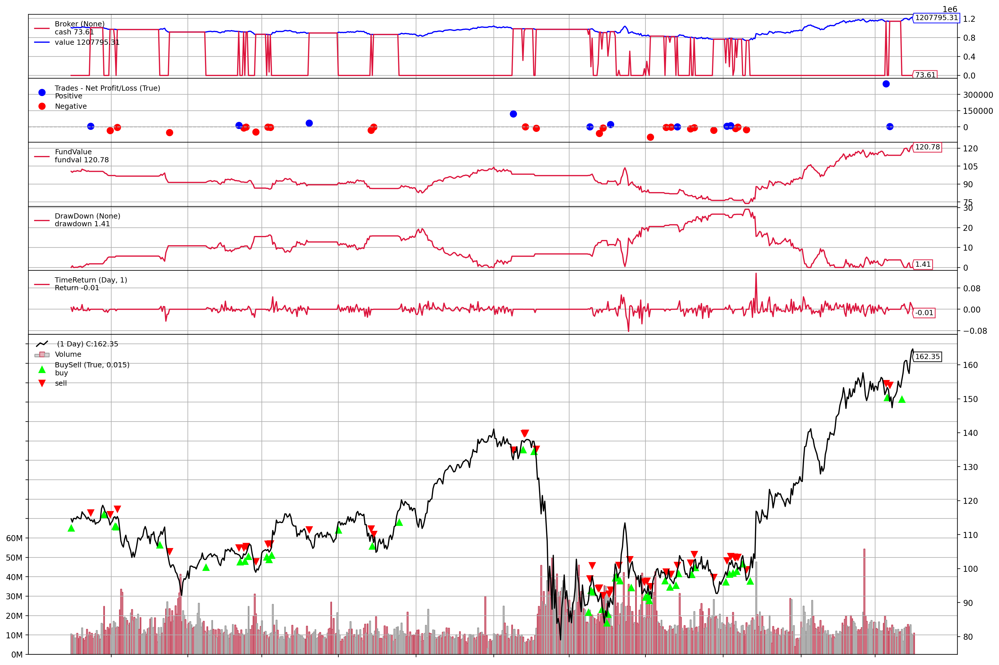

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### JNJ

In [ ]:
jnj_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/JNJ.csv', index_col=0, parse_dates=True)
jnj_data.dropna(inplace=True)
train_len = int(0.7 * len(jnj_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=jnj_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)
cerebro.broker.set_coc(True)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.5965694776820377
Current sigma =  0.17402047130844656
1
2018-08-13T00:00:00, 0060 - Order Target Percent: 1.0000
2018-08-14T00:00:00, BUY EXECUTED, Price: 130.22, Cost: 999959.39, Comm 0.00
Current mu =  0.4679991175071926
Current sigma =  0.1742115708060502
1
2018-08-14T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.36950928067710687
Current sigma =  0.16778307860835018
1
2018-08-15T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.45304257134115855
Current sigma =  0.17228147661210566
1
2018-08-16T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.5618944438368982
Current sigma =  0.17642224056343594
1
2018-08-17T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.6250464161931615
Current sigma =  0.1805879396879954
1
2018-08-20T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.605488386967076
Current sigma =  0.18194278141904377
1
2018-08-21T00:00:00, 0066 - Order Target 

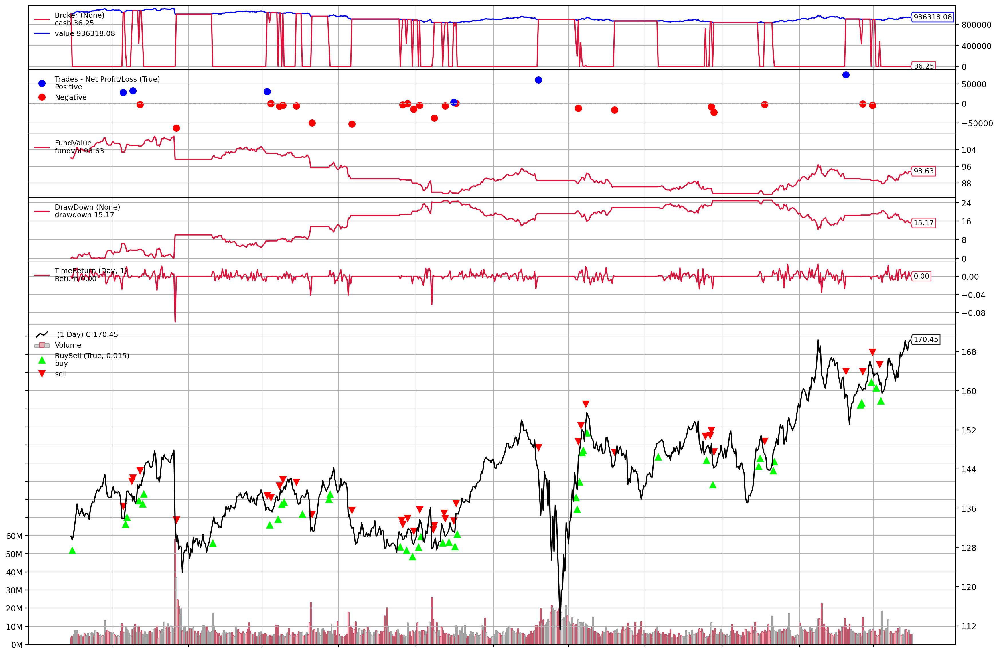

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 13), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### SPY

In [ ]:
spy_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/SPY.csv', index_col=0, parse_dates=True)
spy_data.dropna(inplace=True)
train_len = int(0.7 * len(spy_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=spy_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.32129536446313856
Current sigma =  0.0784862594381477
1
2018-08-13T00:00:00, 0060 - Order Target Percent: 1.0000
2018-08-14T00:00:00, BUY EXECUTED, Price: 282.10, Cost: 999762.42, Comm 0.00
Current mu =  0.40730425797658903
Current sigma =  0.07844882128839492
1
2018-08-14T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.2715693777455354
Current sigma =  0.08021497648497261
1
2018-08-15T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.268408014688783
Current sigma =  0.07993192387979525
1
2018-08-16T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.22105059612830424
Current sigma =  0.07674735323378995
1
2018-08-17T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.2084133054017409
Current sigma =  0.07641522128593432
1
2018-08-20T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.29256324849355014
Current sigma =  0.0724661750551251
1
2018-08-21T00:00:00, 0066 - Order Targe

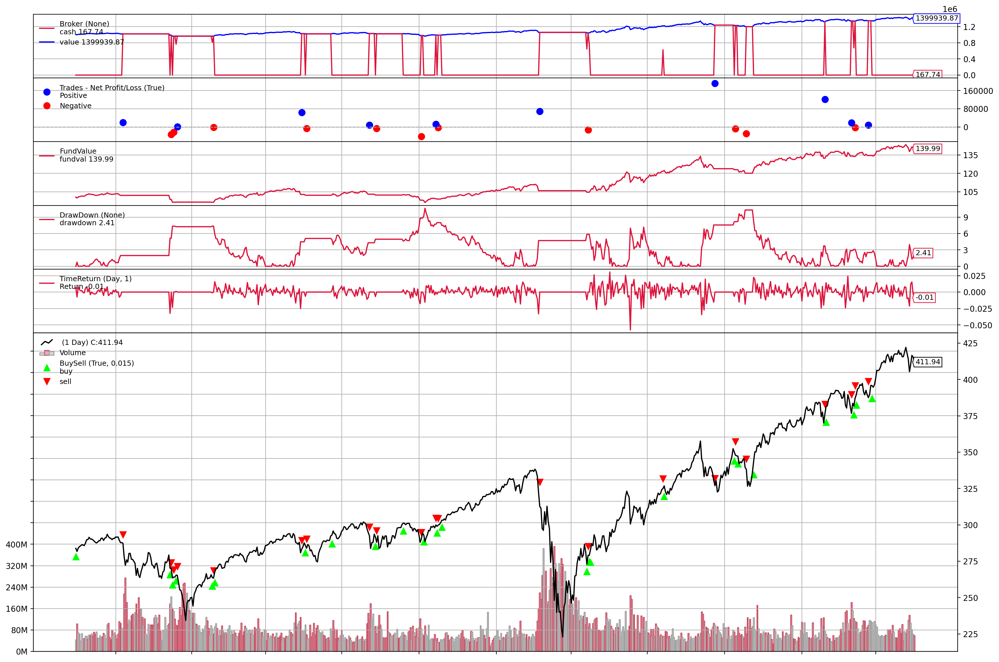

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


##Stocks (HSI)

### 0700 (Tencent)

In [ ]:
tencent_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/0700.HK.csv', index_col=0, parse_dates=True)
tencent_data.dropna(inplace=True)
train_len = int(0.7 * len(tencent_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = tencent_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  -0.010675093563396677
Current sigma =  0.3782779231629261
0
2018-09-27T00:00:00, 0060 - Order Target Percent: 0.0000
Current mu =  -0.3633280957700227
Current sigma =  0.36475158440441924
0
2018-09-28T00:00:00, 0061 - Order Target Percent: 0.0000
Current mu =  -0.8803876554528162
Current sigma =  0.34605745221215906
0
2018-10-02T00:00:00, 0062 - Order Target Percent: 0.0000
Current mu =  -0.9028879846711321
Current sigma =  0.3459486356708695
0
2018-10-03T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  -1.3298503629690923
Current sigma =  0.34015787756402566
0
2018-10-04T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -1.4165060066889146
Current sigma =  0.34032357521350587
0
2018-10-05T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  -1.4672772970778674
Current sigma =  0.3419940877990214
0
2018-10-08T00:00:00, 0066 - Order Target Percent: 0.0000
Current mu =  -1.78988418379926
Current sigma =  0.334

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 1398 (ICBC)

In [ ]:
icbc_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/1398.HK.csv', index_col=0, parse_dates=True)
icbc_data.dropna(inplace=True)
train_len = int(0.7 * len(icbc_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = icbc_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.15380322169134533
Current sigma =  0.21488191630524928
1
2018-09-27T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-28T00:00:00, BUY EXECUTED, Price: 5.70, Cost: 999996.60, Comm 0.00
Current mu =  0.15326067774134167
Current sigma =  0.21487453202465637
1
2018-09-28T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  -0.23256486669316265
Current sigma =  0.23449075336969105
0
2018-10-02T00:00:00, 0062 - Order Target Percent: 0.0000
2018-10-03T00:00:00, SELL EXECUTED, Price: 5.53, Cost: 999996.60, Comm 0.00
Current mu =  -0.2945927938714378
Current sigma =  0.23422824768770195
0
2018-10-03T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  -0.5779618317297465
Current sigma =  0.2411900427763202
0
2018-10-04T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -0.5821492901843273
Current sigma =  0.24127544645260568
0
2018-10-05T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  -0.710721969590914

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 4333 (CISCO-T)

In [ ]:
cisco_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/4333.HK.csv', index_col=0, parse_dates=True)
cisco_data.dropna(inplace=True)
train_len = int(0.7 * len(cisco_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = cisco_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.0
Current sigma =  0.0
0
2018-09-27T00:00:00, 0060 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-09-28T00:00:00, 0061 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-02T00:00:00, 0062 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-03T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-04T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-05T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-08T00:00:00, 0066 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-09T00:00:00, 0067 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-10T00:00:00, 0068 - Order Target Percent: 0.0000
Current mu =  0.0
Current sigma =  0.0
0
2018-10-11T00:00:00, 0069 - Order Target

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 3968 (CM Bank)

In [ ]:
cm_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/3968.HK.csv', index_col=0, parse_dates=True)
cm_data.dropna(inplace=True)
train_len = int(0.7 * len(cm_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = cm_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.9945989360485112
Current sigma =  0.27933559401677155
1
2018-09-27T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-28T00:00:00, BUY EXECUTED, Price: 31.90, Cost: 999969.30, Comm 0.00
Current mu =  0.9064423939678627
Current sigma =  0.2799154192823266
1
2018-09-28T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.5824394091074712
Current sigma =  0.2963778743621599
1
2018-10-02T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.5935290496240458
Current sigma =  0.296508456465495
1
2018-10-03T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.27727562244991893
Current sigma =  0.3066110986273022
1
2018-10-04T00:00:00, 0064 - Order Target Percent: 1.0000
2018-10-05T00:00:00, BUY EXECUTED, Price: 30.25, Cost: 30.25, Comm 0.00
Current mu =  0.249339959103409
Current sigma =  0.30716373765426086
1
2018-10-05T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.14753588487534008
Current sigm

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 939 (CCB)

In [ ]:
ccb_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/0939.HK.csv', index_col=0, parse_dates=True)
ccb_data.dropna(inplace=True)
train_len = int(0.7 * len(ccb_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ccb_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.05134227741082819
Current sigma =  0.2304566302767972
0.9667111198535353
2018-09-27T00:00:00, 0060 - Order Target Percent: 0.9667
2018-09-28T00:00:00, BUY EXECUTED, Price: 6.79, Cost: 966705.88, Comm 0.00
Current mu =  0.0637541757272898
Current sigma =  0.23080075375858122
1
2018-09-28T00:00:00, 0061 - Order Target Percent: 1.0000
2018-10-02T00:00:00, BUY EXECUTED, Price: 6.84, Cost: 33290.28, Comm 0.00
Current mu =  -0.2840853498191899
Current sigma =  0.24856494400167253
0
2018-10-02T00:00:00, 0062 - Order Target Percent: 0.0000
2018-10-03T00:00:00, SELL EXECUTED, Price: 6.62, Cost: 999996.16, Comm 0.00
Current mu =  -0.36051147078678825
Current sigma =  0.24728108567963616
0
2018-10-03T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  -0.6362708350062042
Current sigma =  0.2545983480185505
0
2018-10-04T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -0.7185624963092552
Current sigma =  0.2557235285160607
0
2

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 2318 (Ping An)

In [ ]:
pingan_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/2318.HK.csv', index_col=0, parse_dates=True)
pingan_data.dropna(inplace=True)
train_len = int(0.7 * len(pingan_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = pingan_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  1.2290976756783283
Current sigma =  0.20196150421278797
1
2018-09-27T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-28T00:00:00, BUY EXECUTED, Price: 78.85, Cost: 999975.67, Comm 0.00
Current mu =  1.268758008869888
Current sigma =  0.2021522182563428
1
2018-09-28T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.9430698232193236
Current sigma =  0.22315223144237456
1
2018-10-02T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.8186631826402481
Current sigma =  0.2211007937094447
1
2018-10-03T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.43646543277062133
Current sigma =  0.20354767990109332
1
2018-10-04T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.27698480521699087
Current sigma =  0.1979006088102037
1
2018-10-05T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.1111445132247867
Current sigma =  0.20959638623206708
1
2018-10-08T00:00:00, 0066 - Order Target Pe

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 1288 (ABC)

In [ ]:
abc_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/1288.HK.csv', index_col=0, parse_dates=True)
abc_data.dropna(inplace=True)
train_len = int(0.7 * len(abc_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = abc_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.34716954672249156
Current sigma =  0.22754625866032996
1
2018-09-27T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-28T00:00:00, BUY EXECUTED, Price: 3.83, Cost: 999997.68, Comm 0.00
Current mu =  0.4887037592194772
Current sigma =  0.22302621719010482
1
2018-09-28T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.1405365699962594
Current sigma =  0.23459348032460714
1
2018-10-02T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.04684461572375671
Current sigma =  0.2347303183017952
0.8502004007152485
2018-10-03T00:00:00, 0063 - Order Target Percent: 0.8502
2018-10-04T00:00:00, SELL EXECUTED, Price: 3.72, Cost: 149795.13, Comm 0.00
Current mu =  -0.23550642427597723
Current sigma =  0.24080943475898978
0
2018-10-04T00:00:00, 0064 - Order Target Percent: 0.0000
2018-10-05T00:00:00, SELL EXECUTED, Price: 3.64, Cost: 850202.55, Comm 0.00
Current mu =  -0.23614646605169246
Current sigma =  0.2408141614441555


In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 1299 (AIA)

In [ ]:
aia_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/1299.HK.csv', index_col=0, parse_dates=True)
aia_data.dropna(inplace=True)
train_len = int(0.7 * len(aia_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = aia_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.4390955676560456
Current sigma =  0.2590435350286982
1
2018-09-27T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-28T00:00:00, BUY EXECUTED, Price: 69.00, Cost: 999948.00, Comm 0.00
Current mu =  0.5120571003668036
Current sigma =  0.26097240544277217
1
2018-09-28T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.051609218215150944
Current sigma =  0.27609902937976827
0.6770137989150912
2018-10-02T00:00:00, 0062 - Order Target Percent: 0.6770
2018-10-03T00:00:00, SELL EXECUTED, Price: 67.55, Cost: 322920.00, Comm 0.00
Current mu =  -0.32403660335557355
Current sigma =  0.28161290045537096
0
2018-10-03T00:00:00, 0063 - Order Target Percent: 0.0000
2018-10-04T00:00:00, SELL EXECUTED, Price: 65.80, Cost: 677028.00, Comm 0.00
Current mu =  -0.6162670226437772
Current sigma =  0.29164300452098596
0
2018-10-04T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -0.5544253078256393
Current sigma =  0.29071533154367

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


###0857 (Petrochina)

In [ ]:
petrochina_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/0857.HK.csv', index_col=0, parse_dates=True)
petrochina_data.dropna(inplace=True)
train_len = int(0.7 * len(petrochina_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = petrochina_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.71183154696233
Current sigma =  0.2799911728881006
1
2018-09-27T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-28T00:00:00, BUY EXECUTED, Price: 6.23, Cost: 999995.99, Comm 0.00
Current mu =  0.9094570925816029
Current sigma =  0.282040653129793
1
2018-09-28T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.8199798581023425
Current sigma =  0.28199669896837526
1
2018-10-02T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.9514914001662401
Current sigma =  0.286276694219709
1
2018-10-03T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.6153272315553072
Current sigma =  0.2982776848780437
1
2018-10-04T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.6214703669738316
Current sigma =  0.2980223543162419
1
2018-10-05T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.4666707965830715
Current sigma =  0.30371596518994937
1
2018-10-08T00:00:00, 0066 - Order Target Percent: 1

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 3988 (Bank of China)

In [ ]:
boc_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/3988.HK.csv', index_col=0, parse_dates=True)
boc_data.dropna(inplace=True)
train_len = int(0.7 * len(boc_data))
train_len

1724

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = boc_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  -0.07437696054168501
Current sigma =  0.16833822021630682
0
2018-09-27T00:00:00, 0060 - Order Target Percent: 0.0000
Current mu =  -0.14854473126012707
Current sigma =  0.16752537678759882
0
2018-09-28T00:00:00, 0061 - Order Target Percent: 0.0000
Current mu =  -0.3995947771358467
Current sigma =  0.1787258928505476
0
2018-10-02T00:00:00, 0062 - Order Target Percent: 0.0000
Current mu =  -0.4251902453392506
Current sigma =  0.17870244440466934
0
2018-10-03T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  -0.6290484516518852
Current sigma =  0.1832486878174756
0
2018-10-04T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -0.5559232921632054
Current sigma =  0.18250636462134323
0
2018-10-05T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  -0.5837583280928054
Current sigma =  0.18283568725641622
0
2018-10-08T00:00:00, 0066 - Order Target Percent: 0.0000
Current mu =  -0.6774589120816357
Current sigma =  0.

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


## SSE

### 601628 (China Life Insurance)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601628.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  -0.007875025325603188
Current sigma =  0.20513077807435748
0
2018-09-21T00:00:00, 0060 - Order Target Percent: 0.0000
Current mu =  -0.08677854649848812
Current sigma =  0.20576010691344107
0
2018-09-25T00:00:00, 0061 - Order Target Percent: 0.0000
Current mu =  0.31932093941247314
Current sigma =  0.2058843455657237
1
2018-09-26T00:00:00, 0062 - Order Target Percent: 1.0000
2018-09-27T00:00:00, BUY EXECUTED, Price: 22.45, Cost: 999990.39, Comm 0.00
Current mu =  0.2628080676795711
Current sigma =  0.20481743835082136
1
2018-09-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.4239697024378258
Current sigma =  0.2030606222059632
1
2018-09-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  -0.10335484810963624
Current sigma =  0.23458978824629856
0
2018-10-08T00:00:00, 0065 - Order Target Percent: 0.0000
2018-10-09T00:00:00, SELL EXECUTED, Price: 21.73, Cost: 999990.39, Comm 0.00
Current mu =  -0.2366824978999

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601857 (Petrochina)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601857.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.8489504621660681
Current sigma =  0.2170961051500212
1
2018-09-21T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-25T00:00:00, BUY EXECUTED, Price: 8.81, Cost: 999996.67, Comm 0.00
Current mu =  0.7979639211179269
Current sigma =  0.21504179755770836
1
2018-09-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.9851712781056989
Current sigma =  0.2180914223069672
1
2018-09-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  1.1944750991459032
Current sigma =  0.2085143898150507
1
2018-09-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  1.196969816397511
Current sigma =  0.20853444211441338
1
2018-09-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.6644359216657091
Current sigma =  0.2345746034737644
1
2018-10-08T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  1.0506325666048553
Current sigma =  0.2619463168547966
1
2018-10-09T00:00:00, 0066 - Order Target Percent

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601318 (Ping An Insurance)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601318.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  1.0876244409784324
Current sigma =  0.3073020253849447
1
2018-09-21T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-25T00:00:00, BUY EXECUTED, Price: 67.49, Cost: 999999.30, Comm 0.00
Current mu =  1.1221814692908723
Current sigma =  0.30608197515345187
1
2018-09-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  1.523660252508793
Current sigma =  0.28296884935373234
1
2018-09-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  1.4335573862673754
Current sigma =  0.2867421473387219
1
2018-09-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  1.6612721482668307
Current sigma =  0.2866765216172439
1
2018-09-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.9891878516655291
Current sigma =  0.33514967600082457
1
2018-10-08T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.7799524567934144
Current sigma =  0.3276237754523999
1
2018-10-09T00:00:00, 0066 - Order Target Perce

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601939 (China Construction Bank)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601939.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.6764817594851715
Current sigma =  0.2304231186797241
1
2018-09-21T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-25T00:00:00, BUY EXECUTED, Price: 7.21, Cost: 999998.16, Comm 0.00
Current mu =  0.529867335092285
Current sigma =  0.23628605340722356
1
2018-09-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.7107912167682998
Current sigma =  0.22956292000566858
1
2018-09-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.67120274204289
Current sigma =  0.22964294826359058
1
2018-09-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.9102138370925508
Current sigma =  0.2279921623323443
1
2018-09-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.3453297524026729
Current sigma =  0.25983446232122137
1
2018-10-08T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.2296958890060419
Current sigma =  0.25931137819773376
1
2018-10-09T00:00:00, 0066 - Order Target Percen

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 600036 (China Merchants Bank)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/600036.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.7764585480947659
Current sigma =  0.2977097531265213
1
2018-09-21T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-25T00:00:00, BUY EXECUTED, Price: 30.30, Cost: 999990.87, Comm 0.00
Current mu =  0.6421678431504718
Current sigma =  0.30562715700709564
1
2018-09-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  1.1420155476753409
Current sigma =  0.2979000499293489
1
2018-09-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  1.1232977532152024
Current sigma =  0.29815596448074655
1
2018-09-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  1.2690175671126682
Current sigma =  0.2958877144105706
1
2018-09-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.7617378948242264
Current sigma =  0.32335197667264753
1
2018-10-08T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.7078675347470057
Current sigma =  0.323491238785061
1
2018-10-09T00:00:00, 0066 - Order Target Perce

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601398 (Industrial and Commercial Bank of China)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601398.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.5457181762839828
Current sigma =  0.19721676557545323
1
2018-09-21T00:00:00, 0060 - Order Target Percent: 1.0000
2018-09-25T00:00:00, BUY EXECUTED, Price: 5.75, Cost: 999999.75, Comm 0.00
Current mu =  0.45621335788357653
Current sigma =  0.2020803298817338
1
2018-09-25T00:00:00, 0061 - Order Target Percent: 1.0000
Current mu =  0.64866476208671
Current sigma =  0.1943233538176059
1
2018-09-26T00:00:00, 0062 - Order Target Percent: 1.0000
Current mu =  0.6663217643935165
Current sigma =  0.19383379734794803
1
2018-09-27T00:00:00, 0063 - Order Target Percent: 1.0000
Current mu =  0.8041498465564847
Current sigma =  0.19603529446615983
1
2018-09-28T00:00:00, 0064 - Order Target Percent: 1.0000
Current mu =  0.3183379848725686
Current sigma =  0.22238593121223407
1
2018-10-08T00:00:00, 0065 - Order Target Percent: 1.0000
Current mu =  0.20671700741143467
Current sigma =  0.2224007038185326
1
2018-10-09T00:00:00, 0066 - Order Target Perc

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 600519 (Kweichow Moutai)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/600519.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
train_len = int(0.7 * len(ss_raw_data))
train_len

1701

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data[train_len:])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
Current mu =  0.1362190790533101
Current sigma =  0.31053327178005674
1
2018-06-26T00:00:00, 0060 - Order Target Percent: 1.0000
2018-06-27T00:00:00, BUY EXECUTED, Price: 754.80, Cost: 999355.18, Comm 0.00
Current mu =  -0.14409948772614015
Current sigma =  0.3345827526502787
0
2018-06-27T00:00:00, 0061 - Order Target Percent: 0.0000
2018-06-28T00:00:00, SELL EXECUTED, Price: 722.44, Cost: 999355.18, Comm 0.00
Current mu =  -0.19877657143693925
Current sigma =  0.3365760795137639
0
2018-06-28T00:00:00, 0062 - Order Target Percent: 0.0000
Current mu =  -0.09287753189571497
Current sigma =  0.3437223390032332
0
2018-06-29T00:00:00, 0063 - Order Target Percent: 0.0000
Current mu =  -0.27963230853874455
Current sigma =  0.352367739368277
0
2018-07-02T00:00:00, 0064 - Order Target Percent: 0.0000
Current mu =  -0.5411242848242565
Current sigma =  0.35750591410911287
0
2018-07-03T00:00:00, 0065 - Order Target Percent: 0.0000
Current mu =  -0.4038776947974

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-03-30',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


# Phase 2


## 2 week data


### Parse the raw_data


In [ ]:
raw_data = pd.read_csv('/content/drive/My Drive/lstm_stock_predictions/crypto_2_weeks.csv', index_col=0, parse_dates=True)
crypto_data = {}
for name in raw_data.index.unique() :
  print(name)
  crypto_data[name] = pd.DataFrame()
  crypto_data[name]['Time'] = pd.to_datetime(raw_data.loc[name]['TIME'], format='%d-%m-%y %H:%M:%S')
  crypto_data[name]['Close'] = (raw_data.loc[name]['ASK'] + raw_data.loc[name]['BID'])/2
  crypto_data[name] = crypto_data[name].set_index('Time')
  crypto_data[name] = crypto_data[name].sort_index()


YFI/USD
UNI/USD
LINK/USD
ADA/USD
DOT/USD
DOG/USD
UST/USD
LTC/USD
ETH/USD
BTC/USD


###YFI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['YFI/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['YFI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current mu =  0.01815536722985287
Current sigma =  0.0036278015017466502
1
2021-06-13T03:55:41, 62216 - Order Target Percent: 1.0000
Current mu =  0.020714324880332067
Current sigma =  0.0035678442744886555
1
2021-06-13T03:55:51, 62217 - Order Target Percent: 1.0000
Current mu =  0.022540639072095855
Current sigma =  0.003556125576410416
1
2021-06-13T03:56:01, 62218 - Order Target Percent: 1.0000
Current mu =  0.02180867317197909
Current sigma =  0.003565556165013232
1
2021-06-13T03:56:11, 62219 - Order Target Percent: 1.0000
Current mu =  0.016198527945654514
Current sigma =  0.0031021141051708247
1
2021-06-13T03:56:21, 62220 - Order Target Percent: 1.0000
Current mu =  0.014126355485039625
Current sigma =  0.0030624061566736243
1
2021-06-13T03:56:31, 62221 - Order Target Percent: 1.0000
Current mu =  0.012542965184592818
Current sigma =  0.003078816651467114
1
2021-06-13T03:56:41, 62222 - Order Target Percent: 1.0000
Current mu =  0.

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,42221.9%
Cumulative returns,43.3%
Annual volatility,74.3%
Sharpe ratio,8.58
Calmar ratio,4583.35
Stability,0.67
Max drawdown,-9.2%


Skip


### UNI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UNI/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UNI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current sigma =  0.005380811412784467
0
2021-06-13T03:55:51, 62217 - Order Target Percent: 0.0000
2021-06-13T03:56:01, SELL EXECUTED, Price: 20.94, Cost: 1532896.15, Comm 0.00
Current mu =  0.0012445499516322294
Current sigma =  0.005356650014357697
1
2021-06-13T03:56:01, 62218 - Order Target Percent: 1.0000
2021-06-13T03:56:11, BUY EXECUTED, Price: 20.95, Cost: 1532639.47, Comm 0.00
Current mu =  0.002074150904327132
Current sigma =  0.005363019294396365
1
2021-06-13T03:56:11, 62219 - Order Target Percent: 1.0000
Current mu =  -0.00248850590128364
Current sigma =  0.005197322136134938
0
2021-06-13T03:56:21, 62220 - Order Target Percent: 0.0000
2021-06-13T03:56:31, SELL EXECUTED, Price: 20.95, Cost: 1532639.47, Comm 0.00
Current mu =  -0.0026962352920244146
Current sigma =  0.005202155232508616
0
2021-06-13T03:56:31, 62221 - Order Target Percent: 0.0000
Current mu =  -0.002488624681552209
Current sigma =  0.005205898225034671
0
2021-06

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,116355.6%
Cumulative returns,52.2%
Annual volatility,89.3%
Sharpe ratio,8.41
Calmar ratio,15801.50
Stability,0.75
Max drawdown,-7.4%


Skip


###LINK-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['LINK/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LINK/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current sigma =  0.00720430451424911
1
2021-06-13T03:55:51, 62217 - Order Target Percent: 1.0000
2021-06-13T03:56:01, BUY EXECUTED, Price: 21.08, Cost: 1351800.66, Comm 0.00
Current mu =  0.004535203144082797
Current sigma =  0.007093992195187104
1
2021-06-13T03:56:01, 62218 - Order Target Percent: 1.0000
Current mu =  0.0043276715495105846
Current sigma =  0.007085133398248235
1
2021-06-13T03:56:11, 62219 - Order Target Percent: 1.0000
Current mu =  -0.0008239959394960567
Current sigma =  0.00679996076443073
0
2021-06-13T03:56:21, 62220 - Order Target Percent: 0.0000
2021-06-13T03:56:31, SELL EXECUTED, Price: 21.09, Cost: 1351800.66, Comm 0.00
Current mu =  -0.0028841225559059188
Current sigma =  0.0068120892708755446
0
2021-06-13T03:56:31, 62221 - Order Target Percent: 0.0000
Current mu =  -0.005356354709254702
Current sigma =  0.006814771148170384
0
2021-06-13T03:56:41, 62222 - Order Target Percent: 0.0000
Current mu =  -0.001029567

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,14449.5%
Cumulative returns,34.5%
Annual volatility,78.2%
Sharpe ratio,6.78
Calmar ratio,1317.16
Stability,0.66
Max drawdown,-11.0%


Skip


###ADA-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ADA/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ADA/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current mu =  -0.0038749856483439667
Current sigma =  0.0060601952346340795
0
2021-06-13T03:55:11, 62213 - Order Target Percent: 0.0000
Current mu =  -0.005067288984383205
Current sigma =  0.006056706962313356
0
2021-06-13T03:55:21, 62214 - Order Target Percent: 0.0000
Current mu =  -0.007453685564844987
Current sigma =  0.006140971295130673
0
2021-06-13T03:55:31, 62215 - Order Target Percent: 0.0000
Current mu =  -0.0008949642288572147
Current sigma =  0.0055024199297324106
0
2021-06-13T03:55:41, 62216 - Order Target Percent: 0.0000
Current mu =  -0.0038789773926423874
Current sigma =  0.005608001390038394
0
2021-06-13T03:55:51, 62217 - Order Target Percent: 0.0000
Current mu =  -0.002388170044208956
Current sigma =  0.005486740967687654
0
2021-06-13T03:56:01, 62218 - Order Target Percent: 0.0000
Current mu =  -0.005074425643784174
Current sigma =  0.005437238448292418
0
2021-06-13T03:56:11, 62219 - Order Target Percent: 0.0000
Curren

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###DOT-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOT/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOT/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
1
2021-06-13T03:56:01, 62218 - Order Target Percent: 1.0000
Current mu =  0.008363996147148467
Current sigma =  0.007660222403372377
1
2021-06-13T03:56:11, 62219 - Order Target Percent: 1.0000
Current mu =  0.0017145277365132022
Current sigma =  0.0070654450662948065
1
2021-06-13T03:56:20, 62220 - Order Target Percent: 1.0000
Current mu =  -0.003856641163572795
Current sigma =  0.00684477217052968
0
2021-06-13T03:56:31, 62221 - Order Target Percent: 0.0000
2021-06-13T03:56:41, SELL EXECUTED, Price: 20.27, Cost: 2068481.74, Comm 0.00
Current mu =  -0.004713672571461179
Current sigma =  0.006842644223622936
0
2021-06-13T03:56:41, 62222 - Order Target Percent: 0.0000
Current mu =  -0.010278548469881939
Current sigma =  0.00633895248960767
0
2021-06-13T03:56:51, 62223 - Order Target Percent: 0.0000
Current mu =  -0.01113783906401986
Current sigma =  0.006366545398451028
0
2021-06-13T03:57:01, 62224 - Order Target Percent: 0.0000
Current mu

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###DOG-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOG/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOG/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current sigma =  0.011476631030511
0
2021-06-13T03:51:51, 62193 - Order Target Percent: 0.0000
Current mu =  -0.028797208846774686
Current sigma =  0.011503429954505222
0
2021-06-13T03:52:01, 62194 - Order Target Percent: 0.0000
Current mu =  -0.027811415062136212
Current sigma =  0.011520669136349224
0
2021-06-13T03:52:11, 62195 - Order Target Percent: 0.0000
Current mu =  -0.02893698161562403
Current sigma =  0.011515995083558486
0
2021-06-13T03:52:21, 62196 - Order Target Percent: 0.0000
Current mu =  -0.029360055915058948
Current sigma =  0.011513825581426216
0
2021-06-13T03:52:31, 62197 - Order Target Percent: 0.0000
Current mu =  -0.028936981615624476
Current sigma =  0.011520154605476809
0
2021-06-13T03:52:41, 62198 - Order Target Percent: 0.0000
Current mu =  -0.030204394879845005
Current sigma =  0.01151881890831915
0
2021-06-13T03:52:51, 62199 - Order Target Percent: 0.0000
Current mu =  -0.03147003954710681
Current sigma =  

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-100.0%
Cumulative returns,-69.7%
Annual volatility,280.8%
Sharpe ratio,-4.98
Calmar ratio,-1.30
Stability,0.77
Max drawdown,-76.8%


Skip


###UST-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UST/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UST/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
2021-06-13T03:51:50, 62193 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:52:00, 62194 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:52:10, 62195 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:52:20, 62196 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:52:30, 62197 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:52:40, 62198 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:52:50, 62199 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:53:00, 62200 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:53:10, 62201 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T03:53:20, 62202 - Order Target Percent: 1.0000


In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###LTC-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['LTC/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LTC/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current mu =  -0.0008242760196916102
Current sigma =  0.0050078429805664355
0
2021-06-13T03:57:10, 62225 - Order Target Percent: 0.0000
2021-06-13T03:57:20, SELL EXECUTED, Price: 158.12, Cost: 1118436.80, Comm 0.00
Current mu =  -0.0019230067007634617
Current sigma =  0.004971834997749722
0
2021-06-13T03:57:20, 62226 - Order Target Percent: 0.0000
Current mu =  0.004121510490895174
Current sigma =  0.00472999214121784
1
2021-06-13T03:57:30, 62227 - Order Target Percent: 1.0000
2021-06-13T03:57:40, BUY EXECUTED, Price: 158.17, Cost: 1118226.55, Comm 0.00
Current mu =  0.00247298446076791
Current sigma =  0.004745541128361011
1
2021-06-13T03:57:40, 62228 - Order Target Percent: 1.0000
Current mu =  0.007146098406366226
Current sigma =  0.004452940697977421
1
2021-06-13T03:57:50, 62229 - Order Target Percent: 1.0000
Current mu =  0.006046889815200874
Current sigma =  0.004467181566438807
1
2021-06-13T03:58:00, 62230 - Order Target Percent

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


### ETH-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ETH/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ETH/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current mu =  0.01262141221364604
Current sigma =  0.005817016188409372
1
2021-06-13T03:57:10, 62225 - Order Target Percent: 1.0000
Current mu =  0.015221565118728466
Current sigma =  0.005744071052341516
1
2021-06-13T03:57:20, 62226 - Order Target Percent: 1.0000
Current mu =  0.015230024078582514
Current sigma =  0.005743163851407571
1
2021-06-13T03:57:30, 62227 - Order Target Percent: 1.0000
Current mu =  0.014671103121050705
Current sigma =  0.005737492232303253
1
2021-06-13T03:57:40, 62228 - Order Target Percent: 1.0000
Current mu =  0.02154353622234137
Current sigma =  0.005584902612532414
1
2021-06-13T03:57:50, 62229 - Order Target Percent: 1.0000
Current mu =  0.01652679303494617
Current sigma =  0.005527394276736062
1
2021-06-13T03:58:00, 62230 - Order Target Percent: 1.0000
Current mu =  0.013739175196391524
Current sigma =  0.0054765526237098815
1
2021-06-13T03:58:10, 62231 - Order Target Percent: 1.0000
Current mu =  0.0031

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###BTC-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['BTC/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['BTC/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current sigma =  0.0052278423392525045
1
2021-06-13T03:55:30, 62215 - Order Target Percent: 1.0000
Current mu =  0.007711976181679518
Current sigma =  0.004885931625501762
1
2021-06-13T03:55:40, 62216 - Order Target Percent: 1.0000
Current mu =  0.009328669894765546
Current sigma =  0.0048865698015476446
1
2021-06-13T03:55:50, 62217 - Order Target Percent: 1.0000
Current mu =  0.010946188125936321
Current sigma =  0.0048565600853943455
1
2021-06-13T03:56:00, 62218 - Order Target Percent: 1.0000
Current mu =  0.010448185314205959
Current sigma =  0.004856507664938073
1
2021-06-13T03:56:10, 62219 - Order Target Percent: 1.0000
Current mu =  0.002859522999552148
Current sigma =  0.004140305479095241
1
2021-06-13T03:56:20, 62220 - Order Target Percent: 1.0000
Current mu =  0.00012430752201541545
Current sigma =  0.004039004933961158
1
2021-06-13T03:56:30, 62221 - Order Target Percent: 1.0000
Current mu =  -0.0017402181841875287
Current sig

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


## 1 month data


### Parse the raw_data


In [ ]:
raw_data = pd.read_csv('/content/drive/My Drive/lstm_stock_predictions/crypto_1_month.csv', index_col=0, parse_dates=True)
crypto_data = {}
for name in raw_data.index.unique() :
  print(name)
  crypto_data[name] = pd.DataFrame()
  crypto_data[name]['Time'] = pd.to_datetime(raw_data.loc[name]['TIME'], format='%d-%m-%y %H:%M:%S')
  crypto_data[name]['Close'] = (raw_data.loc[name]['ASK'] + raw_data.loc[name]['BID'])/2
  crypto_data[name] = crypto_data[name].set_index('Time')
  crypto_data[name] = crypto_data[name].sort_index()


UST/USD
BTC/USD
ETH/USD
LTC/BTC
YFI/USD
UNI/USD
LINK/USD
ADA/USD
DOT/USD
DOG/USD


###YFI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['YFI/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['YFI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
0
2021-06-13T08:46:11, 64765 - Order Target Percent: 0.0000
Current mu =  -0.03183269439071012
Current sigma =  0.004357371784638401
0
2021-06-13T08:46:21, 64766 - Order Target Percent: 0.0000
Current mu =  -0.0340024411370427
Current sigma =  0.004402360708609349
0
2021-06-13T08:46:31, 64767 - Order Target Percent: 0.0000
Current mu =  -0.03388065124997133
Current sigma =  0.004407423058300327
0
2021-06-13T08:46:41, 64768 - Order Target Percent: 0.0000
Current mu =  -0.028961738569980557
Current sigma =  0.004275096301330641
0
2021-06-13T08:46:51, 64769 - Order Target Percent: 0.0000
Current mu =  -0.030165141497682808
Current sigma =  0.004257642502791677
0
2021-06-13T08:47:01, 64770 - Order Target Percent: 0.0000
Current mu =  -0.03750521002864096
Current sigma =  0.004440943819887537
0
2021-06-13T08:47:11, 64771 - Order Target Percent: 0.0000
Current mu =  -0.036792097286644974
Current sigma =  0.004429067996371992
0
2021-06-13T08:

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-13
End date,2021-06-13
Total months,1
,Backtest
Annual return,26562.6%
Cumulative returns,103.3%
Annual volatility,120.9%
Sharpe ratio,5.18
Calmar ratio,2645.69
Stability,0.83
Max drawdown,-10.0%


Skip


### UNI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UNI/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UNI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
0
2021-06-13T08:47:21, 64772 - Order Target Percent: 0.0000
Current mu =  -0.036031218136513804
Current sigma =  0.006955374063921091
0
2021-06-13T08:47:31, 64773 - Order Target Percent: 0.0000
Current mu =  -0.029993805871937555
Current sigma =  0.006996717259113397
0
2021-06-13T08:47:41, 64774 - Order Target Percent: 0.0000
Current mu =  -0.025834185308360406
Current sigma =  0.0069198568696155925
0
2021-06-13T08:47:51, 64775 - Order Target Percent: 0.0000
Current mu =  -0.02979587112043777
Current sigma =  0.0069186452989648895
0
2021-06-13T08:48:01, 64776 - Order Target Percent: 0.0000
Current mu =  -0.0347899155450981
Current sigma =  0.006684104918915489
0
2021-06-13T08:48:11, 64777 - Order Target Percent: 0.0000
Current mu =  -0.027281776434836546
Current sigma =  0.007156634811304428
0
2021-06-13T08:48:21, 64778 - Order Target Percent: 0.0000
Current mu =  -0.024999025217673193
Current sigma =  0.007086221508589731
0
2021-06-13

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-13
End date,2021-06-13
Total months,1
,Backtest
Annual return,13747.5%
Cumulative returns,87.0%
Annual volatility,114.3%
Sharpe ratio,4.84
Calmar ratio,1513.34
Stability,0.77
Max drawdown,-9.1%


Skip


###LINK-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['LINK/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LINK/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current mu =  -0.03608769328176366
Current sigma =  0.0068061387396777945
0
2021-06-13T08:47:51, 64775 - Order Target Percent: 0.0000
Current mu =  -0.04147715649037312
Current sigma =  0.006625734142426686
0
2021-06-13T08:48:01, 64776 - Order Target Percent: 0.0000
Current mu =  -0.04872580956849485
Current sigma =  0.006195223095114669
0
2021-06-13T08:48:11, 64777 - Order Target Percent: 0.0000
Current mu =  -0.03358044631114803
Current sigma =  0.007190313924987357
0
2021-06-13T08:48:21, 64778 - Order Target Percent: 0.0000
Current mu =  -0.03462803398383738
Current sigma =  0.007217488490144883
0
2021-06-13T08:48:31, 64779 - Order Target Percent: 0.0000
Current mu =  -0.0335916646617586
Current sigma =  0.007235206380242704
0
2021-06-13T08:48:41, 64780 - Order Target Percent: 0.0000
Current mu =  -0.03941175673124445
Current sigma =  0.007405236029994243
0
2021-06-13T08:48:51, 64781 - Order Target Percent: 0.0000
Current mu =  -0.0

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-13
End date,2021-06-13
Total months,1
,Backtest
Annual return,19727.0%
Cumulative returns,95.8%
Annual volatility,92.7%
Sharpe ratio,6.19
Calmar ratio,1798.23
Stability,0.92
Max drawdown,-11.0%


Skip


###ADA-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ADA/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ADA/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
0
2021-06-13T08:48:41, 64780 - Order Target Percent: 0.0000
Current mu =  -0.024622557824880126
Current sigma =  0.00623892795392332
0
2021-06-13T08:48:51, 64781 - Order Target Percent: 0.0000
Current mu =  -0.02941781885518276
Current sigma =  0.005909131309820072
0
2021-06-13T08:49:01, 64782 - Order Target Percent: 0.0000
Current mu =  -0.03693450577318059
Current sigma =  0.006155116703710876
0
2021-06-13T08:49:11, 64783 - Order Target Percent: 0.0000
Current mu =  -0.03242412408415006
Current sigma =  0.006391075411998976
0
2021-06-13T08:49:21, 64784 - Order Target Percent: 0.0000
Current mu =  -0.028519734756724757
Current sigma =  0.006495986023187085
0
2021-06-13T08:49:31, 64785 - Order Target Percent: 0.0000
Current mu =  -0.032121125599609085
Current sigma =  0.0064097558911377596
0
2021-06-13T08:49:41, 64786 - Order Target Percent: 0.0000
Current mu =  -0.03061537578772605
Current sigma =  0.006475216867301625
0
2021-06-13T08

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###DOT-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOT/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOT/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current mu =  -0.01719904455141
Current sigma =  0.007219972100661141
0
2021-06-13T08:47:31, 64773 - Order Target Percent: 0.0000
Current mu =  -0.01846988956229159
Current sigma =  0.007177297379814583
0
2021-06-13T08:47:41, 64774 - Order Target Percent: 0.0000
Current mu =  -0.013378994440323274
Current sigma =  0.0069946730906279035
0
2021-06-13T08:47:51, 64775 - Order Target Percent: 0.0000
Current mu =  -0.012319427156902735
Current sigma =  0.006974607179231643
0
2021-06-13T08:48:01, 64776 - Order Target Percent: 0.0000
Current mu =  -0.018683328440838066
Current sigma =  0.006501356138490782
0
2021-06-13T08:48:11, 64777 - Order Target Percent: 0.0000
Current mu =  -0.009974572002960688
Current sigma =  0.007091222370055645
0
2021-06-13T08:48:21, 64778 - Order Target Percent: 0.0000
Current mu =  -0.011464766971533103
Current sigma =  0.007166594390001403
0
2021-06-13T08:48:31, 64779 - Order Target Percent: 0.0000
Current mu =  -

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###DOG-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOG/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOG/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current sigma =  0.009273320371863325
1
2021-06-13T08:44:01, 64752 - Order Target Percent: 1.0000
Current mu =  0.004762529551515243
Current sigma =  0.009134855821035992
1
2021-06-13T08:44:11, 64753 - Order Target Percent: 1.0000
Current mu =  -0.00490058956188861
Current sigma =  0.008688952166293501
0
2021-06-13T08:44:21, 64754 - Order Target Percent: 0.0000
Current mu =  -0.0021000157603360352
Current sigma =  0.00872969629026893
0
2021-06-13T08:44:31, 64755 - Order Target Percent: 0.0000
Current mu =  0.03378314136290631
Current sigma =  0.016662963802954168
1
2021-06-13T08:44:41, 64756 - Order Target Percent: 1.0000
Current mu =  0.052592449893558026
Current sigma =  0.017244880346192176
1
2021-06-13T08:44:51, 64757 - Order Target Percent: 1.0000
Current mu =  0.014688281435442839
Current sigma =  0.02273326907406316
1
2021-06-13T08:45:01, 64758 - Order Target Percent: 1.0000
Current mu =  0.020968917944703593
Current sigma =  0.

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-13
End date,2021-06-13
Total months,1
,Backtest
Annual return,-100.0%
Cumulative returns,-69.7%
Annual volatility,192.4%
Sharpe ratio,-3.48
Calmar ratio,-1.34
Stability,0.48
Max drawdown,-74.6%


Skip


###UST-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UST/USD']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UST/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current sigma =  0.0
1
2021-06-13T08:44:10, 64753 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:44:20, 64754 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:44:30, 64755 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:44:40, 64756 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:44:50, 64757 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:45:00, 64758 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:45:10, 64759 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:45:20, 64760 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:45:30, 64761 - Order Target Percent: 1.0000
Current mu =  0.0
Current sigma =  0.0
1
2021-06-13T08:45:40, 64762 - Order 

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###LTC-BTC

In [ ]:
train_len = int(0.7 * len(crypto_data['LTC/BTC']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LTC/BTC'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
2021-06-13T08:46:40, 64768 - Order Target Percent: 0.0000
Current mu =  -0.008967006416159768
Current sigma =  0.002748745372440859
0
2021-06-13T08:46:50, 64769 - Order Target Percent: 0.0000
Current mu =  -0.009544146361914183
Current sigma =  0.002710486627758637
0
2021-06-13T08:47:00, 64770 - Order Target Percent: 0.0000
Current mu =  -0.00751933820436529
Current sigma =  0.0027642932565554346
0
2021-06-13T08:47:10, 64771 - Order Target Percent: 0.0000
Current mu =  -0.009255083767792842
Current sigma =  0.002778220789968198
0
2021-06-13T08:47:20, 64772 - Order Target Percent: 0.0000
Current mu =  -0.008676352154363938
Current sigma =  0.0027925319753053517
0
2021-06-13T08:47:30, 64773 - Order Target Percent: 0.0000
Current mu =  -0.010508901306808233
Current sigma =  0.0028220387194889335
0
2021-06-13T08:47:40, 64774 - Order Target Percent: 0.0000
Current mu =  -0.012246898448793503
Current sigma =  0.0029223318345507135
0
2021-06-

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


### ETH-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ETH/USD']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ETH/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current mu =  -0.027663512387971784
Current sigma =  0.006630903709364756
0
2021-06-13T08:49:30, 64785 - Order Target Percent: 0.0000
Current mu =  -0.024525967534641428
Current sigma =  0.006724555540342228
0
2021-06-13T08:49:40, 64786 - Order Target Percent: 0.0000
Current mu =  -0.021195864810669183
Current sigma =  0.007015466998469016
0
2021-06-13T08:49:50, 64787 - Order Target Percent: 0.0000
Current mu =  -0.019722205189893018
Current sigma =  0.0070236261003339545
0
2021-06-13T08:50:00, 64788 - Order Target Percent: 0.0000
Current mu =  -0.0027652045332489544
Current sigma =  0.006769784959039023
0
2021-06-13T08:50:10, 64789 - Order Target Percent: 0.0000
Current mu =  -0.0003687526065647167
Current sigma =  0.006715444609442784
0
2021-06-13T08:50:20, 64790 - Order Target Percent: 0.0000
Current mu =  -0.010698593977042968
Current sigma =  0.007338593287294566
0
2021-06-13T08:50:30, 64791 - Order Target Percent: 0.0000
Current 

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###BTC-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['BTC/USD']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Normal_Kelly_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['BTC/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current sigma =  0.004315285921522744
0
2021-06-13T08:47:40, 64774 - Order Target Percent: 0.0000
Current mu =  -0.00988730124813895
Current sigma =  0.004302146207136502
0
2021-06-13T08:47:50, 64775 - Order Target Percent: 0.0000
Current mu =  -0.011109984874104068
Current sigma =  0.004342037226754336
0
2021-06-13T08:48:00, 64776 - Order Target Percent: 0.0000
Current mu =  -0.010377020833990044
Current sigma =  0.004356329753859824
0
2021-06-13T08:48:10, 64777 - Order Target Percent: 0.0000
Current mu =  -0.007080044220514799
Current sigma =  0.0044610977500879724
0
2021-06-13T08:48:20, 64778 - Order Target Percent: 0.0000
Current mu =  -0.0039061762709445176
Current sigma =  0.004486568660773723
0
2021-06-13T08:48:30, 64779 - Order Target Percent: 0.0000
Current mu =  -0.004516738410139964
Current sigma =  0.004490984387382902
0
2021-06-13T08:48:40, 64780 - Order Target Percent: 0.0000
Current mu =  -0.005615049612851607
Current si

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip
